In [4]:
from popframe.method.popuation_frame import PopulationFrame
from popframe.models.region import Region


In [5]:
region_model = Region.from_pickle('/Users/mvin/Code/PopFrame/examples/data/Ленинградская область.pickle')
frame_method = PopulationFrame(region=region_model)
G = frame_method.build_network_frame()
frame_method.get_graph_html(G, 'final_graph_with_legend.html')

### Test 1

/var/folders/h8/0wmx2zx90bn60jw8zc1r4qjc0000gn/T/ipykernel_1678/2992623525.py:69: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = plt.cm.get_cmap('viridis', max(partition.values()) + 1)
/Users/mvin/Code/PopFrame/.venv/lib/python3.10/site-packages/networkx/drawing/nx_pylab.py:433: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  node_collection = ax.scatter(


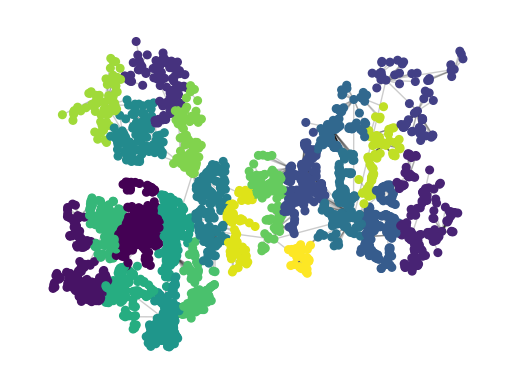

In [3]:
import networkx as nx
import numpy as np
import geopandas as gpd
from shapely.geometry import Polygon
from scipy.spatial import Voronoi
from sklearn.cluster import AgglomerativeClustering
from shapely.ops import unary_union, polygonize
import matplotlib.pyplot as plt

# Функция для обнаружения агломераций с использованием агломеративной кластеризации
def detect_agglomerations(G):
    pos = np.array([data['pos'] for node, data in G.nodes(data=True)])
    clustering = AgglomerativeClustering(n_clusters=None, distance_threshold=5.0).fit(pos)
    partition = {node: label for node, label in zip(G.nodes(), clustering.labels_)}
    return partition

# Функция для создания полигона Вороного
def create_voronoi_polygons(towns_gdf, boundary_gdf):
    points = np.array([point.coords[0] for point in towns_gdf.geometry])
    vor = Voronoi(points)
    polygons = []
    node_indices = []
    
    for point_index, region_index in enumerate(vor.point_region):
        region = vor.regions[region_index]
        if not -1 in region and len(region) > 0:
            polygon = Polygon([vor.vertices[i] for i in region])
            clipped_polygon = polygon.intersection(boundary_gdf.geometry.unary_union)
            if not clipped_polygon.is_empty:
                polygons.append(clipped_polygon)
                node_indices.append(point_index)
    
    return gpd.GeoDataFrame({'geometry': polygons, 'node_index': node_indices}, crs=towns_gdf.crs)

# Функция для построения агломераций и их Вороного полигона
def build_agglomeration_voronoi(G, towns_gdf, boundary_gdf):
    partition = detect_agglomerations(G)
    voronoi_gdf = create_voronoi_polygons(towns_gdf, boundary_gdf)
    
    agglomerations = {}
    for node, agglomeration_id in partition.items():
        if agglomeration_id not in agglomerations:
            agglomerations[agglomeration_id] = []
        agglomerations[agglomeration_id].append(node)
    
    polygons = []
    names = []
    
    for agglomeration_id, nodes in agglomerations.items():
        agglomeration_polygons = voronoi_gdf[voronoi_gdf['node_index'].isin(nodes)].geometry
        if len(agglomeration_polygons) > 0:
            union_polygon = unary_union(agglomeration_polygons)
            separate_polygons = list(polygonize(union_polygon))
            
            for polygon in separate_polygons:
                cities_within_polygon = towns_gdf[towns_gdf.geometry.within(polygon)]
                if not cities_within_polygon.empty:
                    largest_city = cities_within_polygon.sort_values(by='population', ascending=False).iloc[0]['name']
                    polygons.append(polygon)
                    names.append(largest_city)
    
    agglomeration_gdf = gpd.GeoDataFrame({'name': names, 'geometry': polygons}, crs=towns_gdf.crs)
    return agglomeration_gdf

# Функция для визуализации агломераций
def visualize_agglomerations(G):
    partition = detect_agglomerations(G)
    pos = nx.get_node_attributes(G, 'pos')
    cmap = plt.cm.get_cmap('viridis', max(partition.values()) + 1)
    node_colors = [cmap(partition[node]) for node in G.nodes()]
    
    nx.draw_networkx_nodes(G, pos, node_color=node_colors, node_size=30, cmap=cmap)
    nx.draw_networkx_edges(G, pos, alpha=0.2)
    plt.axis('off')
    plt.show()


boundary_gdf = region_model.region
towns_gdf = region_model.get_towns_gdf()


agglomeration_gdf = build_agglomeration_voronoi(G, towns_gdf, boundary_gdf)

visualize_agglomerations(G)


In [4]:
towns = region_model.get_towns_gdf()
m = agglomeration_gdf.explore()
towns.explore(m=m)

### Test 2

In [51]:
import networkx as nx
import pandas as pd
import geopandas as gpd
from shapely.geometry import Point
import shapely
import json

class AgglomerationBuilder:
    def __init__(self, city_graph, city_crs="EPSG:4326"):
        self.city_graph = city_graph
        self.city_crs = city_crs  # Изначальная CRS (скорее всего, WGS84)
        self.utm_crs = "EPSG:32636"  # Метрическая CRS для буферов
        self.walk_speed = 4 * 1000 / 60  # Средняя скорость ходьбы (метров в минуту)
        # Уровни для агломераций, от самого низкого до самого высокого
        self.levels = [
            "Малое сельское поселение",
            "Среднее сельское поселение",
            "Большое сельское поселение",
            "Крупное сельское поселение",
            "Малый город",
            "Средний город",
            "Большой город",
            "Крупный город",
            "Крупнейший город",
            "Сверхкрупный город"
        ]
    
    def build_agglomeration(self, max_time, weight_type='time'):
        # Получаем узлы с максимальным уровнем в графе
        node_levels = nx.get_node_attributes(self.city_graph, 'level')
        node_names = nx.get_node_attributes(self.city_graph, 'name')  # Получаем имена городов
        # Находим самый высокий уровень
        max_level = max(node_levels.values(), key=lambda x: self.levels.index(x))
        # Получаем все узлы с самым высоким уровнем
        high_level_nodes = [
            n for n, d in self.city_graph.nodes(data=True) if d['level'] == max_level
        ]
        
        # Строим агломерации для каждого узла с максимальным уровнем
        agglomerations = []
        for node in high_level_nodes:
            agglomeration = self._get_agglomeration_around_node(node, max_time, weight_type)
            if agglomeration:
                agglomeration["name"] = node_names.get(node, "Unnamed")  # Добавляем имя города
                agglomerations.append(agglomeration)
        
        # Создаем GeoDataFrame с отдельными агломерациями и их названиями
        if agglomerations:
            agglomeration_gdf = gpd.GeoDataFrame(
                agglomerations, columns=["name", "geometry"]
            ).set_crs(self.utm_crs).to_crs("EPSG:4326")  # Преобразуем в WGS84 для вывода, если нужно
        else:
            agglomeration_gdf = gpd.GeoDataFrame(columns=["name", "geometry"])

        return agglomeration_gdf  # Возвращаем GeoDataFrame
    
    def _get_agglomeration_around_node(self, start_node, max_time, weight_type):
        # Используем время как вес рёбер для расчётов
        mobility_graph = self.city_graph
        
        # Проверяем, есть ли стартовый узел в графе
        if start_node not in mobility_graph:
            print(f"Node {start_node} not found in the mobility graph.")
            return None

        # Вычисляем расстояния от стартового узла до других с учетом времени
        weights_sum = nx.single_source_dijkstra_path_length(
            mobility_graph, start_node, cutoff=max_time, weight=weight_type
        )

        # Собираем данные о выбранных узлах
        nodes_data = pd.DataFrame.from_records(
            [d for u, d in mobility_graph.nodes(data=True)], index=list(mobility_graph.nodes())
        ).sort_index()
        
        # Убедимся, что у каждого узла есть атрибут 'geometry'
        if 'geometry' not in nodes_data.columns:
            # Преобразуем 'pos' в координаты и добавляем 'geometry'
            nodes_data['geometry'] = nodes_data.apply(lambda row: Point(row['pos']), axis=1)
        
        # Фильтруем узлы по рассчитанным путям
        nodes_data = nodes_data.loc[list(weights_sum.keys())].reset_index()

        # Преобразуем 'geometry' в GeoSeries и задаём изначальную CRS (WGS84)
        nodes_gdf = gpd.GeoDataFrame(nodes_data, geometry='geometry', crs=self.city_crs)

        # Преобразуем координаты узлов в метрическую систему (UTM)
        nodes_gdf = nodes_gdf.to_crs(self.utm_crs)

        # Создаем буфер вокруг узлов в зависимости от оставшегося времени
        distance = dict((k, (max_time - v) * self.walk_speed) for k, v in weights_sum.items())
        nodes_gdf["left_distance"] = distance.values()
        agglomeration_geom = nodes_gdf.buffer(nodes_gdf["left_distance"]).unary_union
        
        return {"geometry": agglomeration_geom}

# Пример использования:
# Подготовим граф города (city_graph), зададим CRS и вызовем функцию создания агломераций
city_graph = G
# Добавление узлов и рёбер в city_graph
# Пример:
# city_graph.add_node(0, pos=(33.758921961102764, 59.3622632565), level="Малое сельское поселение", name="Болото", population=10)
# city_graph.add_edge(0, 1, level="Малое сельское поселение", time=10.484)

# Зададим начальную CRS (WGS84)
city_crs = "EPSG:4326"

# Создаем объект агломерации
agglomeration_builder = AgglomerationBuilder(city_graph, city_crs)

# Строим агломерации с максимальным временем 60 минут
agglomeration_result = agglomeration_builder.build_agglomeration(max_time=60)

# Выводим результат
print(agglomeration_result)


         name                                           geometry
0      Кириши  MULTIPOLYGON (((31.80477 59.32362, 31.80102 59...
1  Всеволожск  MULTIPOLYGON (((30.53597 59.82617, 30.53293 59...
2   Сертолово  MULTIPOLYGON (((30.12436 59.56849, 30.12421 59...
3      Мурино  MULTIPOLYGON (((29.97826 59.41905, 29.97822 59...
4      Выборг  MULTIPOLYGON (((28.63738 60.36184, 28.63583 60...
5     Гатчина  MULTIPOLYGON (((29.28509 59.34813, 29.28499 59...
6      Тихвин  MULTIPOLYGON (((33.18602 59.38031, 33.18441 59...


In [52]:
agglomeration_result.explore()

### Test 3

In [6]:
gdf = region_model.get_towns_gdf()
gdf

,id,name,population,level,geometry
0,0,Болото,10,Малое сельское поселение,POINT (33.75892 59.36226)
1,1,Большой Остров,68,Малое сельское поселение,POINT (33.78600 59.47517)
2,2,Бор,1734,Большое сельское поселение,POINT (33.79236 59.47356)
3,3,Бороватое,10,Малое сельское поселение,POINT (33.77572 59.44249)
4,4,Бочево,10,Малое сельское поселение,POINT (33.67728 59.32819)
...,...,...,...,...,...
2925,2925,Апраксин Бор,313,Среднее сельское поселение,POINT (31.23421 59.17021)
2926,2926,Александровка,313,Среднее сельское поселение,POINT (31.31924 59.18702)
2927,2927,Большая Горка,313,Среднее сельское поселение,POINT (31.47462 59.29408)
2928,2928,Дроздово,5,Малое сельское поселение,POINT (31.46265 59.30308)


In [7]:
connectivity_matrix = region_model.accessibility_matrix
connectivity_matrix 


,0,1,2,3,4,5,6,7,8,9,...,2920,2921,2922,2923,2924,2925,2926,2927,2928,2929
0,0.000,11.687,12.024,10.794,7.768,3.431,21.873,29.029,8.415,17.122,...,175.052,167.133,165.000,170.273,195.276,195.276,188.976,172.755,171.412,183.300
1,11.687,0.000,0.337,4.313,18.027,13.690,29.914,37.070,16.456,10.347,...,163.986,156.067,153.934,159.207,184.210,184.210,177.910,161.689,160.346,172.234
2,12.024,0.337,0.000,4.650,18.364,14.027,30.251,37.407,16.248,10.684,...,163.649,155.730,153.597,158.870,183.873,183.873,177.573,161.352,160.009,171.897
3,10.794,4.313,4.650,0.000,17.134,12.797,29.021,36.177,15.563,9.748,...,167.678,159.759,157.626,162.899,187.902,187.902,181.602,165.381,164.038,175.926
4,7.768,18.027,18.364,17.134,0.000,4.337,28.213,35.369,14.755,23.462,...,181.392,173.473,171.340,176.613,201.616,201.616,195.316,179.095,177.752,189.640
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2925,195.416,184.350,184.013,188.042,201.756,197.419,213.643,220.799,197.758,194.076,...,24.994,29.115,31.820,32.255,0.000,0.000,17.446,39.575,38.232,32.092
2926,189.115,178.049,177.712,181.741,195.455,191.118,207.342,214.498,191.457,187.775,...,17.942,22.063,24.768,25.203,17.446,17.446,0.000,32.523,31.180,25.040
2927,172.898,161.832,161.495,165.524,179.238,174.901,191.125,198.281,175.240,171.558,...,18.603,10.684,7.755,13.824,39.579,39.579,32.527,0.000,1.343,26.851
2928,171.555,160.489,160.152,164.181,177.895,173.558,189.782,196.938,173.897,170.215,...,17.260,9.341,6.412,12.481,38.236,38.236,31.184,1.343,0.000,25.508


In [139]:
import networkx as nx
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt


# Создаем граф
G_2 = nx.Graph()

# Добавляем вершины с атрибутами
for i, row in gdf.iterrows():
    G_2.add_node(row['id'], name=row['name'], population=row['population'], level=row['level'], pos=(row['geometry'].x, row['geometry'].y))

# Фильтр: добавляем рёбра только если время меньше или равно 60 минут
time_threshold = 80

for i in range(connectivity_matrix.shape[0]):
    for j in range(i + 1, connectivity_matrix.shape[1]):  # избегаем повторного добавления
        weight = connectivity_matrix.iloc[i, j]
        if weight > 0 and weight <= time_threshold:  # Только если есть связь и время меньше или равно 60 минут
            G_2.add_edge(i, j, time=weight)

In [49]:
import networkx as nx

class WeightsCalculator:
    def __init__(self, city_graph):
        self.city_graph = city_graph
    
    def calculate_weights(self, start_node, max_time, weight_type='time'):
        # Проверяем, есть ли стартовый узел в графе
        if start_node not in self.city_graph:
            print(f"Node {start_node} not found in the graph.")
            return None

        # Вычисляем минимальные пути от стартового узла до всех узлов с ограничением по времени (max_time)
        weights_sum = nx.single_source_dijkstra_path_length(
            self.city_graph, start_node, cutoff=max_time, weight=weight_type
        )

        return weights_sum  # Возвращаем словарь с минимальными путями (время)

# Пример использования:
# Создаем граф с узлами и рёбрами, где время указано как вес рёбер
city_graph = G_2
weights_calculator = WeightsCalculator(city_graph)
weights_sum = weights_calculator.calculate_weights(start_node=0, max_time=60)

In [142]:
import networkx as nx
import pandas as pd
import geopandas as gpd
from shapely.geometry import Point
import shapely
import json

class AgglomerationBuilder:
    def __init__(self, city_graph, city_crs="EPSG:4326"):
        self.city_graph = city_graph
        self.city_crs = city_crs  # Изначальная CRS (скорее всего, WGS84)
        self.utm_crs = "EPSG:32636"  # Метрическая CRS для буферов
        self.radius = 400  # Скорость
        # Уровни для агломераций, от самого низкого до самого высокого
        self.levels = [
            "Малое сельское поселение",
            "Среднее сельское поселение",
            "Большое сельское поселение",
            "Крупное сельское поселение",
            "Малый город",
            "Средний город",
            "Большой город",
            "Крупный город",
            "Крупнейший город",
            "Сверхкрупный город"
        ]
    
    def build_agglomeration(self, max_time, weight_type='time'):
        # Получаем узлы с максимальным уровнем в графе
        node_levels = nx.get_node_attributes(self.city_graph, 'level')
        node_names = nx.get_node_attributes(self.city_graph, 'name')  # Получаем имена городов
        # Находим самый высокий уровень
        max_level = max(node_levels.values(), key=lambda x: self.levels.index(x))
        # Получаем все узлы с самым высоким уровнем
        high_level_nodes = [
            n for n, d in self.city_graph.nodes(data=True) if d['level'] == max_level
        ]
        
        # Строим агломерации для каждого узла с максимальным уровнем
        agglomerations = []
        for node in high_level_nodes:
            agglomeration = self._get_agglomeration_around_node(node, max_time, weight_type)
            if agglomeration:
                agglomeration["name"] = node_names.get(node, "Unnamed")  # Добавляем имя города
                agglomerations.append(agglomeration)
        
        # Создаем GeoDataFrame с отдельными агломерациями и их названиями
        if agglomerations:
            agglomeration_gdf = gpd.GeoDataFrame(
                agglomerations, columns=["name", "geometry"]
            ).set_crs(self.utm_crs).to_crs("EPSG:4326")  # Преобразуем в WGS84 для вывода, если нужно
        else:
            agglomeration_gdf = gpd.GeoDataFrame(columns=["name", "geometry"])

        return agglomeration_gdf  # Возвращаем GeoDataFrame
    
    def _get_agglomeration_around_node(self, start_node, max_time, weight_type):
        # Используем время как вес рёбер для расчётов
        mobility_graph = self.city_graph
        
        # Проверяем, есть ли стартовый узел в графе
        if start_node not in mobility_graph:
            print(f"Node {start_node} not found in the mobility graph.")
            return None

        # Вычисляем расстояния от стартового узла до других с учетом времени
        weights_sum = nx.single_source_dijkstra_path_length(
            mobility_graph, start_node, cutoff=max_time, weight=weight_type
        )

        # Собираем данные о выбранных узлах
        nodes_data = pd.DataFrame.from_records(
            [d for u, d in mobility_graph.nodes(data=True)], index=list(mobility_graph.nodes())
        ).sort_index()
        
        # Убедимся, что у каждого узла есть атрибут 'geometry'
        if 'geometry' not in nodes_data.columns:
            # Преобразуем 'pos' в координаты и добавляем 'geometry'
            nodes_data['geometry'] = nodes_data.apply(lambda row: Point(row['pos']), axis=1)
        
        # Фильтруем узлы по рассчитанным путям
        nodes_data = nodes_data.loc[list(weights_sum.keys())].reset_index()

        # Преобразуем 'geometry' в GeoSeries и задаём изначальную CRS (WGS84)
        nodes_gdf = gpd.GeoDataFrame(nodes_data, geometry='geometry', crs=self.city_crs)

        # Преобразуем координаты узлов в метрическую систему (UTM)
        nodes_gdf = nodes_gdf.to_crs(self.utm_crs)

        # Создаем буфер вокруг узлов в зависимости от оставшегося времени, переведенного в метры
        distance = dict((k, (max_time - v) * self.radius) for k, v in weights_sum.items())
        nodes_gdf["left_distance"] = distance.values()
        agglomeration_geom = nodes_gdf.buffer(nodes_gdf["left_distance"]).unary_union
        return {"geometry": agglomeration_geom}

# Пример использования:
# Подготовим граф города (city_graph), зададим CRS и вызовем функцию создания агломераций
city_graph = G_2

# Зададим начальную CRS (WGS84)
city_crs = "EPSG:4326"

# Создаем объект агломерации
agglomeration_builder = AgglomerationBuilder(city_graph, city_crs)

# Строим агломерации с максимальным временем 60 минут
agglomeration_result = agglomeration_builder.build_agglomeration(max_time=30)

# Выводим результат в виде GeoDataFrame
print(agglomeration_result)


         name                                           geometry
0      Кириши  MULTIPOLYGON (((31.82700 59.31027, 31.82058 59...
1  Всеволожск  MULTIPOLYGON (((30.48197 59.86844, 30.47419 59...
2   Сертолово  MULTIPOLYGON (((30.29063 60.02522, 30.27380 60...
3      Мурино  MULTIPOLYGON (((30.36421 59.95187, 30.34481 59...
4      Выборг  MULTIPOLYGON (((28.68179 60.42506, 28.68145 60...
5     Гатчина  MULTIPOLYGON (((29.56375 59.45758, 29.56350 59...
6      Тихвин  MULTIPOLYGON (((33.21282 59.49761, 33.21236 59...


In [143]:
towns = region_model.get_towns_gdf()
m = agglomeration_result.explore(tiles='CartoDB positron')
towns.explore(m=m)

### Тест 4

In [202]:
class AgglomerationBuilder:
    def __init__(self, city_graph, city_crs="EPSG:4326"):
        self.city_graph = city_graph
        self.city_crs = city_crs  # Изначальная CRS (скорее всего, WGS84)
        self.utm_crs = "EPSG:32636"  # Метрическая CRS для буферов
        self.radius = 300  # Скорость
        # Уровни для агломераций, только городские
        self.city_levels = [
            "Малый город",
            "Средний город",
            "Большой город",
            "Крупный город",
            "Крупнейший город",
            "Сверхкрупный город"
        ]
    
    def build_agglomeration(self, weight_type='time'):
        # Получаем узлы с уровнями в графе
        node_population = nx.get_node_attributes(self.city_graph, 'population')
        node_names = nx.get_node_attributes(self.city_graph, 'name')  # Получаем имена городов

        agglomerations = []
        
        # Обрабатываем агломерации для каждого уровня города, начиная с самого высокого
        for level_index, level in enumerate(reversed(self.city_levels)):
            # Для каждого уровня задаем соответствующее максимальное время (80 - 10 * индекс уровня)
            max_time = 80 - 10 * level_index
            
            # Получаем все узлы с текущим уровнем, относящимся к городам
            level_nodes = [
                n for n, d in self.city_graph.nodes(data=True) if d['level'] == level
            ]
            
            # Строим агломерации для каждого узла с текущим уровнем
            for node in level_nodes:
                agglomeration = self._get_agglomeration_around_node(node, max_time, weight_type)
                if agglomeration:
                    agglomeration["name"] = node_names.get(node, "Unnamed")  # Добавляем имя города
                    agglomeration["population"]  = node_population.get(node, "Unnamed")  # Добавляем имя города
                    agglomeration["level"] = level  # Добавляем уровень города
                    agglomerations.append(agglomeration)

        # Создаем GeoDataFrame с отдельными агломерациями и их названиями
        if agglomerations:
            agglomeration_gdf = gpd.GeoDataFrame(
                agglomerations, columns=["name", "level", "population", "geometry"]
            ).set_crs(self.utm_crs).to_crs("EPSG:4326")  # Преобразуем в WGS84 для вывода, если нужно
        else:
            agglomeration_gdf = gpd.GeoDataFrame(columns=["name", "level", "geometry"])

        return agglomeration_gdf  # Возвращаем GeoDataFrame
    
    def _get_agglomeration_around_node(self, start_node, max_time, weight_type):
        # Используем время как вес рёбер для расчётов
        mobility_graph = self.city_graph
        
        # Проверяем, есть ли стартовый узел в графе
        if start_node not in mobility_graph:
            print(f"Node {start_node} not found in the mobility graph.")
            return None

        # Вычисляем расстояния от стартового узла до других с учетом времени
        weights_sum = nx.single_source_dijkstra_path_length(
            mobility_graph, start_node, cutoff=max_time, weight=weight_type
        )

        # Собираем данные о выбранных узлах
        nodes_data = pd.DataFrame.from_records(
            [d for u, d in mobility_graph.nodes(data=True)], index=list(mobility_graph.nodes())
        ).sort_index()
        
        # Убедимся, что у каждого узла есть атрибут 'geometry'
        if 'geometry' not in nodes_data.columns:
            # Преобразуем 'pos' в координаты и добавляем 'geometry'
            nodes_data['geometry'] = nodes_data.apply(lambda row: Point(row['pos']), axis=1)
        
        # Фильтруем узлы по рассчитанным путям
        nodes_data = nodes_data.loc[list(weights_sum.keys())].reset_index()

        # Преобразуем 'geometry' в GeoSeries и задаём изначальную CRS (WGS84)
        nodes_gdf = gpd.GeoDataFrame(nodes_data, geometry='geometry', crs=self.city_crs)

        # Преобразуем координаты узлов в метрическую систему (UTM)
        nodes_gdf = nodes_gdf.to_crs(self.utm_crs)

        # Создаем буфер вокруг узлов в зависимости от оставшегося времени, переведенного в метры
        distance = dict((k, (max_time - v) * self.radius) for k, v in weights_sum.items())
        nodes_gdf["left_distance"] = distance.values()
        agglomeration_geom = nodes_gdf.buffer(nodes_gdf["left_distance"]).unary_union
        return {"geometry": agglomeration_geom}


# Пример использования:
# Подготовим граф города (city_graph), зададим CRS и вызовем функцию создания агломераций
city_graph = G_2

# Зададим начальную CRS (WGS84)
city_crs = "EPSG:4326"

# Создаем объект агломерации
agglomeration_builder = AgglomerationBuilder(city_graph, city_crs)

# Строим агломерации с максимальным временем 60 минут
agglomeration_result = agglomeration_builder.build_agglomeration()

# Выводим результат в виде GeoDataFrame
agglomeration_result.explore()

### Тест 5

In [287]:
class AgglomerationBuilder:
    def __init__(self, city_graph, city_crs="EPSG:4326"):
        self.city_graph = city_graph
        self.city_crs = city_crs  # Изначальная CRS (скорее всего, WGS84)
        self.utm_crs = "EPSG:32636"  # Метрическая CRS для буферов
        self.radius = 500  # Скорость
        self.city_levels = [
            "Малый город",
            "Средний город",
            "Большой город",
            "Крупный город",
            "Крупнейший город",
            "Сверхкрупный город"
        ]
        # Словарь для отслеживания городов, которые уже находятся в агломерации
        self.in_agglomeration = {}

    def build_agglomeration(self, weight_type='time'):
        node_population = nx.get_node_attributes(self.city_graph, 'population')
        node_names = nx.get_node_attributes(self.city_graph, 'name')  # Имена городов

        agglomerations = []
        
        # Обрабатываем агломерации для каждого уровня города, начиная с самого высокого
        for level_index, level in enumerate(reversed(self.city_levels)):
            max_time = 80 - 10 * level_index

            # Фильтрация узлов по уровню города
            level_nodes = [
                (n, d['population']) for n, d in self.city_graph.nodes(data=True) if d['level'] == level
            ]
            
            # Сортировка узлов по населению в порядке убывания
            level_nodes = sorted(level_nodes, key=lambda x: x[1], reverse=True)

            # Строим агломерации для каждого узла с текущим уровнем
            for node, population in level_nodes:
                # Если узел уже находится в агломерации, пропускаем его
                if node in self.in_agglomeration:
                    continue

                agglomeration = self._get_agglomeration_around_node(node, max_time, weight_type)

                if agglomeration:
                    agglomeration["name"] = node_names.get(node, "Unnamed")
                    agglomeration["population"] = node_population.get(node, "Unnamed")
                    agglomeration["level"] = level
                    agglomerations.append(agglomeration)

                    # Отмечаем все узлы, которые входят в агломерацию, чтобы избежать повторной обработки
                    for member_node in agglomeration["nodes_in_agglomeration"]:
                        self.in_agglomeration[member_node] = True

        # Создаем GeoDataFrame с отдельными агломерациями и их названиями
        if agglomerations:
            agglomeration_gdf = gpd.GeoDataFrame(
                agglomerations, columns=["name", "level", "population", "geometry"]
            ).set_crs(self.utm_crs)
        else:
            agglomeration_gdf = gpd.GeoDataFrame(columns=["name", "level", "geometry"])

        return agglomeration_gdf  # Возвращаем GeoDataFrame

    
    def _get_agglomeration_around_node(self, start_node, max_time, weight_type):
        mobility_graph = self.city_graph
        
        if start_node not in mobility_graph:
            print(f"Node {start_node} not found in the mobility graph.")
            return None

        weights_sum = nx.single_source_dijkstra_path_length(
            mobility_graph, start_node, cutoff=max_time, weight=weight_type
        )

        nodes_data = pd.DataFrame.from_records(
            [d for u, d in mobility_graph.nodes(data=True)], index=list(mobility_graph.nodes())
        ).sort_index()
        
        if 'geometry' not in nodes_data.columns:
            nodes_data['geometry'] = nodes_data.apply(lambda row: Point(row['pos']), axis=1)
        
        nodes_data = nodes_data.loc[list(weights_sum.keys())].reset_index()

        nodes_gdf = gpd.GeoDataFrame(nodes_data, geometry='geometry', crs=self.city_crs)
        nodes_gdf = nodes_gdf.to_crs(self.utm_crs)

        distance = dict((k, (max_time - v) * self.radius) for k, v in weights_sum.items())
        nodes_gdf["left_distance"] = distance.values()
        agglomeration_geom = nodes_gdf.buffer(nodes_gdf["left_distance"]).unary_union
        
        return {
            "geometry": agglomeration_geom,
            "nodes_in_agglomeration": list(weights_sum.keys())  # Возвращаем список узлов внутри агломерации
        }

# Пример использования:
city_graph = G_2
city_crs = "EPSG:4326"
agglomeration_builder = AgglomerationBuilder(city_graph, city_crs)
agglomeration_result = agglomeration_builder.build_agglomeration()
agglomeration_result.explore()


In [288]:
agglomeration_result

,name,level,population,geometry
0,Гатчина,Средний город,94377,"MULTIPOLYGON (((309420.197 6587321.381, 309323..."
1,Выборг,Средний город,79850,"MULTIPOLYGON (((259861.541 6699396.829, 259737..."
2,Мурино,Средний город,78184,"MULTIPOLYGON (((341139.660 6613492.751, 341127..."
3,Тихвин,Средний город,58097,"MULTIPOLYGON (((509834.802 6583018.206, 509806..."
4,Кириши,Средний город,52411,"MULTIPOLYGON (((434397.980 6568776.052, 433393..."
5,Кингисепп,Малый город,47969,"MULTIPOLYGON (((231251.891 6566431.604, 231243..."
6,Волхов,Малый город,39694,"MULTIPOLYGON (((453616.947 6617652.877, 453548..."
7,Тосно,Малый город,39077,"MULTIPOLYGON (((355807.171 6589050.241, 355760..."
8,Луга,Малый город,36496,"MULTIPOLYGON (((306797.999 6486440.916, 306699..."
9,Сланцы,Малый город,33300,"MULTIPOLYGON (((217650.789 6542845.639, 216795..."


In [365]:
import geopandas as gpd
from shapely.ops import unary_union
from shapely.geometry import MultiPolygon, Polygon

def merge_and_remove_isolated_parts(gdf, buffer_distance=10000):
    """
    Функция для объединения разрозненных частей агломераций и удаления изолированных частей.
    gdf: GeoDataFrame с агломерациями
    buffer_distance: Расстояние буферизации для соединения частей
    """
    # Создаем копию входного GeoDataFrame, чтобы не изменять оригинал
    gdf = gdf.copy()
    
    # Проходим по каждой строке GeoDataFrame и выполняем объединение разрозненных частей
    for idx, row in gdf.iterrows():
        # Буферизация для соединения частей мультиполигона
        buffered_geometry = row['geometry'].buffer(buffer_distance)
        
        # Выполняем объединение всех частей в единую геометрию
        unified_geometry = unary_union(buffered_geometry)
        
        # Если результат является мультиполигоном, сохраняем только те части, которые соединены
        if isinstance(unified_geometry, MultiPolygon):
            # Находим самый большой полигон
            largest_polygon = max(unified_geometry.geoms, key=lambda poly: poly.area)
            
            # Фильтруем все полигоны, удаляя только изолированные маленькие части
            filtered_polygons = [poly for poly in unified_geometry.geoms if poly.intersects(largest_polygon)]
            unified_geometry = MultiPolygon(filtered_polygons) if len(filtered_polygons) > 1 else filtered_polygons[0]
        
        # Если результат уже полигон, его можно оставить без изменений
        elif isinstance(unified_geometry, Polygon):
            pass  # Ничего не делаем, т.к. это уже один полигон
        
        # Обновляем геометрию
        gdf.at[idx, 'geometry'] = unified_geometry
    
    return gdf
# Пример использования
# Допустим, ваш GeoDataFrame с агломерациями называется agglomeration_gdf

# Объединение геометрий и сохранение самой крупной части
agglomeration_gdf_fixed = merge_and_remove_isolated_parts(agglomeration_result, buffer_distance=1000)

# Выводим результат
agglomeration_gdf_fixed.explore()


In [367]:
import geopandas as gpd

# Загрузим данные (предположим, что ваши данные уже находятся в виде GeoDataFrame)
gdf = agglomeration_gdf_fixed
# Копируем исходные геометрии для редактирования
gdf['geometry_copy'] = gdf['geometry']

# Проходим по каждой агломерации и вырезаем пересекающиеся части
for i, row_i in gdf.iterrows():
    current_geometry = row_i['geometry']  # Исходная геометрия агломерации
    
    # Проходим по всем другим агломерациям
    for j, row_j in gdf.iterrows():
        if i != j:  # Сравниваем с другими агломерациями
            intersection = current_geometry.intersection(row_j['geometry'])
            
            if not intersection.is_empty:
                # Вычисляем долю пересечения
                area_i_in_j = intersection.area / row_i['geometry'].area
                area_j_in_i = intersection.area / row_j['geometry'].area
                
                # Вырезаем часть из текущей агломерации
                if area_i_in_j > area_j_in_i:
                    current_geometry = current_geometry.difference(row_j['geometry'])
    
    # Обновляем геометрию после всех вырезаний
    gdf.at[i, 'geometry_copy'] = current_geometry

# Обновляем основной столбец геометрии
gdf['geometry'] = gdf['geometry_copy']
gdf.drop(columns=['geometry_copy'], inplace=True)

region_boundary = region_model.region
region_boundary = region_boundary.to_crs(gdf.crs)
gdf = gpd.overlay(gdf, region_boundary, how='intersection')

gdf['geometry'] = gdf['geometry'].buffer(-1000)  # Уменьшение границ 
gdf['geometry'] = gdf['geometry'].buffer(990)    # Увеличение границ 

gdf = merge_and_remove_isolated_parts(gdf, buffer_distance=0)

gdf['geometry'] = gdf['geometry'].apply(lambda geom: Polygon(geom.exterior) if geom.is_valid else geom)


towns = region_model.get_towns_gdf()
m = gdf.explore(tiles='CartoDB positron')
towns.explore(m=m)

### Финал 

In [369]:
import networkx as nx
import geopandas as gpd
import pandas as pd
from shapely.geometry import Point, Polygon, MultiPolygon
from shapely.ops import unary_union

class AgglomerationBuilder:
    def __init__(self, city_graph, city_crs="EPSG:4326"):
        self.city_graph = city_graph
        self.city_crs = city_crs  # Изначальная CRS (скорее всего, WGS84)
        self.utm_crs = "EPSG:32636"  # Метрическая CRS для буферов
        self.radius = 500  # Скорость
        self.city_levels = [
            "Малый город",
            "Средний город",
            "Большой город",
            "Крупный город",
            "Крупнейший город",
            "Сверхкрупный город"
        ]
        self.in_agglomeration = {}

    def build_agglomeration(self, weight_type='time'):
        node_population = nx.get_node_attributes(self.city_graph, 'population')
        node_names = nx.get_node_attributes(self.city_graph, 'name')

        agglomerations = []
        
        for level_index, level in enumerate(reversed(self.city_levels)):
            max_time = 80 - 10 * level_index

            level_nodes = [
                (n, d['population']) for n, d in self.city_graph.nodes(data=True) if d['level'] == level
            ]
            level_nodes = sorted(level_nodes, key=lambda x: x[1], reverse=True)

            for node, population in level_nodes:
                if node in self.in_agglomeration:
                    continue

                agglomeration = self._get_agglomeration_around_node(node, max_time, weight_type)

                if agglomeration:
                    agglomeration["name"] = node_names.get(node, "Unnamed")
                    agglomeration["population"] = node_population.get(node, "Unnamed")
                    agglomeration["level"] = level
                    agglomerations.append(agglomeration)

                    for member_node in agglomeration["nodes_in_agglomeration"]:
                        self.in_agglomeration[member_node] = True

        if agglomerations:
            agglomeration_gdf = gpd.GeoDataFrame(
                agglomerations, columns=["name", "level", "population", "geometry"]
            ).set_crs(self.utm_crs)
        else:
            agglomeration_gdf = gpd.GeoDataFrame(columns=["name", "level", "geometry"])

        return agglomeration_gdf

    
    def _get_agglomeration_around_node(self, start_node, max_time, weight_type):
        mobility_graph = self.city_graph
        
        if start_node not in mobility_graph:
            print(f"Node {start_node} not found in the mobility graph.")
            return None

        weights_sum = nx.single_source_dijkstra_path_length(
            mobility_graph, start_node, cutoff=max_time, weight=weight_type
        )

        nodes_data = pd.DataFrame.from_records(
            [d for u, d in mobility_graph.nodes(data=True)], index=list(mobility_graph.nodes())
        ).sort_index()
        
        if 'geometry' not in nodes_data.columns:
            nodes_data['geometry'] = nodes_data.apply(lambda row: Point(row['pos']), axis=1)
        
        nodes_data = nodes_data.loc[list(weights_sum.keys())].reset_index()

        nodes_gdf = gpd.GeoDataFrame(nodes_data, geometry='geometry', crs=self.city_crs)
        nodes_gdf = nodes_gdf.to_crs(self.utm_crs)

        distance = dict((k, (max_time - v) * self.radius) for k, v in weights_sum.items())
        nodes_gdf["left_distance"] = distance.values()
        agglomeration_geom = nodes_gdf.buffer(nodes_gdf["left_distance"]).unary_union
        
        return {
            "geometry": agglomeration_geom,
            "nodes_in_agglomeration": list(weights_sum.keys())
        }

def merge_and_remove_isolated_parts(gdf, buffer_distance=10000):
    gdf = gdf.copy()
    
    for idx, row in gdf.iterrows():
        buffered_geometry = row['geometry'].buffer(buffer_distance)
        unified_geometry = unary_union(buffered_geometry)
        
        if isinstance(unified_geometry, MultiPolygon):
            largest_polygon = max(unified_geometry.geoms, key=lambda poly: poly.area)
            filtered_polygons = [poly for poly in unified_geometry.geoms if poly.intersects(largest_polygon)]
            unified_geometry = MultiPolygon(filtered_polygons) if len(filtered_polygons) > 1 else filtered_polygons[0]
        
        elif isinstance(unified_geometry, Polygon):
            pass
        
        gdf.at[idx, 'geometry'] = unified_geometry
    
    return gdf

def remove_intersections(gdf):
    gdf['geometry_copy'] = gdf['geometry']

    for i, row_i in gdf.iterrows():
        current_geometry = row_i['geometry']
        
        for j, row_j in gdf.iterrows():
            if i != j:
                intersection = current_geometry.intersection(row_j['geometry'])
                
                if not intersection.is_empty:
                    area_i_in_j = intersection.area / row_i['geometry'].area
                    area_j_in_i = intersection.area / row_j['geometry'].area
                    
                    if area_i_in_j > area_j_in_i:
                        current_geometry = current_geometry.difference(row_j['geometry'])
        
        gdf.at[i, 'geometry_copy'] = current_geometry

    gdf['geometry'] = gdf['geometry_copy']
    gdf.drop(columns=['geometry_copy'], inplace=True)
    
    return gdf

# Основная логика работы с агломерациями
city_graph = G_2
city_crs = "EPSG:4326"
agglomeration_builder = AgglomerationBuilder(city_graph, city_crs)
agglomeration_result = agglomeration_builder.build_agglomeration()

# Убираем разрозненные части агломераций
agglomeration_gdf_fixed = merge_and_remove_isolated_parts(agglomeration_result, buffer_distance=1000)

# Убираем пересекающиеся части агломераций
agglomeration_gdf_fixed = remove_intersections(agglomeration_gdf_fixed)

# Наложение на границы региона
region_boundary = region_model.region
region_boundary = region_boundary.to_crs(agglomeration_gdf_fixed.crs)
agglomeration_gdf_fixed = gpd.overlay(agglomeration_gdf_fixed, region_boundary, how='intersection')

# Уменьшение и увеличение границ агломераций для корректировки
agglomeration_gdf_fixed['geometry'] = agglomeration_gdf_fixed['geometry'].buffer(-1000)
agglomeration_gdf_fixed['geometry'] = agglomeration_gdf_fixed['geometry'].buffer(990)

# Повторное объединение и удаление изолированных частей
agglomeration_gdf_fixed = merge_and_remove_isolated_parts(agglomeration_gdf_fixed, buffer_distance=10)

# Финальная корректировка геометрий
agglomeration_gdf_fixed['geometry'] = agglomeration_gdf_fixed['geometry'].apply(
    lambda geom: Polygon(geom.exterior) if geom.is_valid else geom
)

# Отображение результата
towns = region_model.get_towns_gdf()
m = agglomeration_gdf_fixed.explore(tiles='CartoDB positron')
towns.explore(m=m)


### Base

/Users/mvin/Code/PopFrame/.venv/lib/python3.10/site-packages/networkx/drawing/nx_pylab.py:433: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  node_collection = ax.scatter(


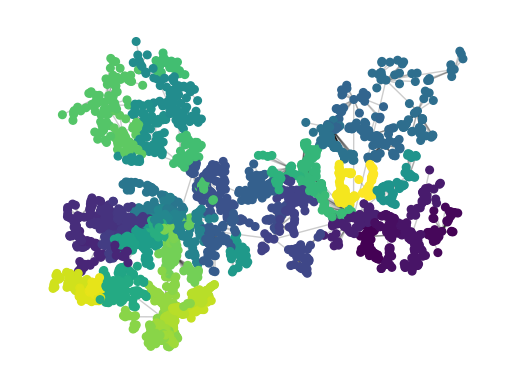

In [5]:
from popframe.method.aglomeration import AgglomerationAnalysis
agglomeration = AgglomerationAnalysis(region=region_model)
agglomerations_gdf = agglomeration.build_agglomeration_voronoi(G)
agglomeration.visualize_agglomerations(G)

In [6]:
towns = region_model.get_towns_gdf()
m = agglomerations_gdf.explore()
towns.explore(m=m)